In [1]:
seed <- 124
set.seed(seed)
options(ggrepel.max.overlaps=100)

suppressPackageStartupMessages({
    library(magrittr)
    library(dplyr)
    library(purrr)

    library(ggplot2)
    theme_set(theme_bw() + theme())
    library(patchwork)

    library(SingleCellExperiment)
    library(multisce)
    library(scutility)
    
    library(anndata)
    library(reticulate)
})


use_condaenv(condaenv='scvi-tools', required=TRUE)
sc <- import('scanpy', convert = FALSE)
anndata <- import('anndata', convert = FALSE)
pd <- import('pandas', convert = FALSE)

In [2]:
adata <- anndata::read_h5ad(here::here("data", "adata", "skin_scANVI.h5ad"))
adata

AnnData object with n_obs × n_vars = 229041 × 2983
    obs: 'run', 'sum', 'detected', 'subsets_Mito_sum', 'subsets_Mito_detected', 'subsets_Mito_percent', 'total', 'sizeFactor', 'louvain', 'cluster', 'label', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'Doublet_cluster', 'doublet', 'dead_cell', 'cc_phase', 'cc_score_S', 'cc_score_G2M', 'ann_singleR_encode', 'cell_type_singleR_encode', 'ann_singleR_HCA', 'cell_type_singleR_HCA', 'cell_type', 'sample', 'tissue', 'study', 'donor', 'TRA.1.v_gene', 'TRA.1.d_gene', 'TRA.1.j_gene', 'TRA.1.c_gene', 'TRA.1.cdr3', 'TRA.1.cdr3_nt', 'TRA.1.umis', 'TRA.1.reads', 'TRA.1.high_confidence', 'TRA.1.productive', 'TRA.1.full_length', 'TRA.1.raw_clonotype_id', 'TRA.2.v_gene', 'TRA.2.d_gene', 'TRA.2.j_gene', 'TRA.2.c_gene', 'TRA.2.cdr3', 'TRA.2.cdr3_nt', 'TRA.2.umis', 'TRA.2.reads', 'TRA.2.high_confidence', 'TRA.2.productive', 'TRA.2.full_length', 'TRA.2.raw_clonotype_id', 'TRB.1.v_gene', 'TRB.1.d_gene', 'TRB.

In [3]:
sce <- multisce_load(path=here::here("data", "multisce", "all"), main_name="RNA", reduceddim_include=c())
sce

Loading RNA from /home/tbb/git/CTCL_KC_HLAII/data/multisce/all/sce/RNA.rds

Loading coldata from /home/tbb/git/CTCL_KC_HLAII/data/multisce/all/coldata.rds



class: SingleCellExperiment 
dim: 36601 259927 
metadata(1): multisce_path
assays(2): counts logcounts
rownames(36601): MIR1302-2HG FAM138A ... AC007325.4 AC007325.2
rowData names(0):
colnames(259927): AAACCTGAGACAAGCC-1_1 AAACCTGAGCTAGTTC-1_1 ...
  TTTGTCATCTGATACG-1_39 TTTGTCATCTTCGGTC-1_39
colData names(193): run sum ... age sex
reducedDimNames(0):
mainExpName: RNA
altExpNames(0):

In [4]:
sce <- scutility::scVI_load(adata=adata, sce=sce[, rownames(adata)], reducedDim_include=c("X_scANVI", "X_umap", "X_scVI"))
sce

class: SingleCellExperiment 
dim: 36601 229041 
metadata(1): multisce_path
assays(2): counts logcounts
rownames(36601): MIR1302-2HG FAM138A ... AC007325.4 AC007325.2
rowData names(0):
colnames(229041): AAACCTGAGACAAGCC-1_1 AAACCTGAGCTAGTTC-1_1 ...
  TTTGTCATCTGATACG-1_39 TTTGTCATCTTCGGTC-1_39
colData names(205): run sum ... leiden_scANVI_15 leiden_scANVI_20
reducedDimNames(3): scANVI umap scVI
mainExpName: RNA
altExpNames(1): VI_RNA

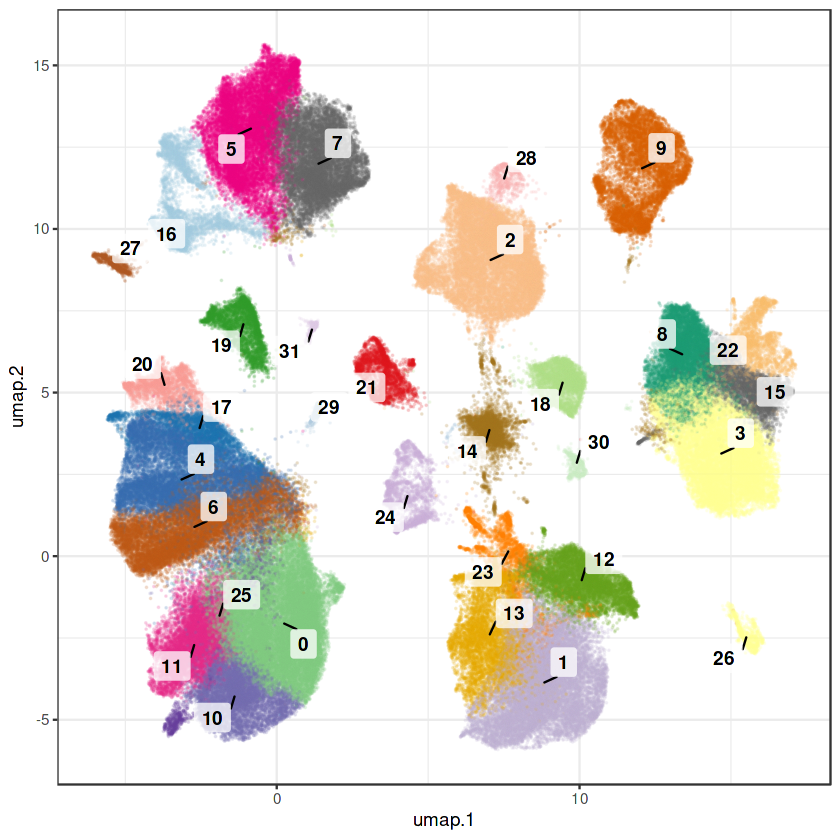

In [5]:
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="leiden_scANVI_10", 
                       text_by="leiden_scANVI_10", 
                       scale_color=scale_color_manual(values=scutility::colors_get_distinct()),
                       point_size=0.025, point_alpha=0.15, 
                       shuffle=TRUE) + 
    theme(legend.position="none")

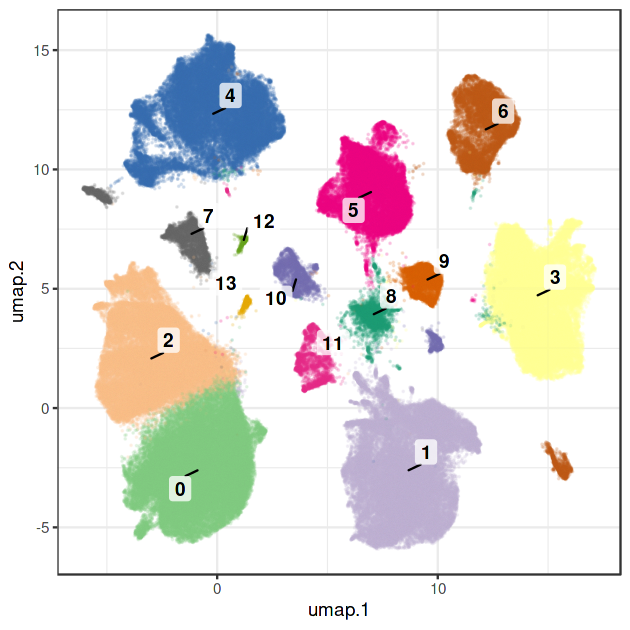

In [6]:
options(repr.plot.width=5.25, repr.plot.height=5.25)
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="leiden_scANVI_02", 
                       text_by="leiden_scANVI_02", 
                       scale_color=scale_color_manual(values=scutility::colors_get_distinct()),
                       point_size=0.025, point_alpha=0.15, 
                       shuffle=TRUE) + 
    theme(legend.position="none")

In [9]:
sce$lesion <- "Lesional"
sce$lesion[grepl("HC", sce$run)] <- "Healthy"

In [10]:
sce$lesional <- sce$lesion
sce$lesional[!sce$lesional %in% c("Healthy", "Non-lesional")] <- "Lesional"

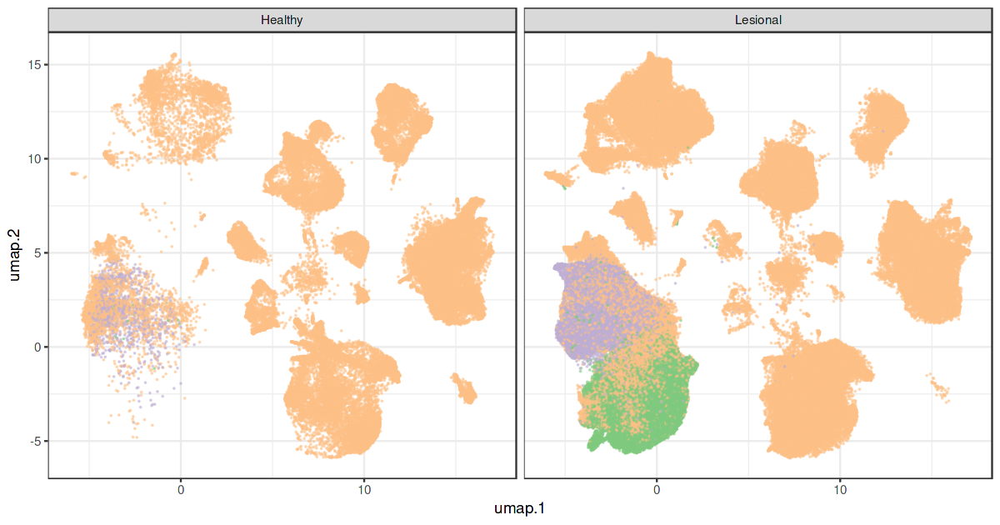

In [11]:
options(repr.plot.width=2*5, repr.plot.height=5.25)
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="Malignant", 
                       #text_by="leiden_scANVI_10", 
                       scale_color=scale_color_manual(values=scutility::colors_get_distinct()),
                       point_size=0.015, point_alpha=0.5, 
                       shuffle=TRUE) + 
    theme(legend.position="none") + 
    facet_wrap(~ lesional)

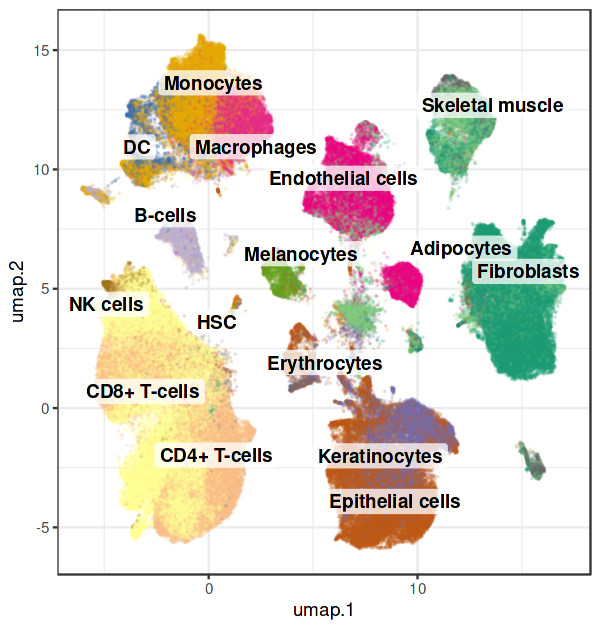

In [10]:
options(repr.plot.width=5, repr.plot.height=5.25)
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="cell_type_singleR_encode", 
                       text_by="cell_type_singleR_encode", 
                       scale_color=scale_color_manual(values=scutility::colors_get_distinct()),
                       point_size=0.025, point_alpha=0.15, 
                       shuffle=TRUE) + 
    theme(legend.position="none")

In [12]:
# From https://www.sciencedirect.com/science/article/pii/S107476132030409X
gating_single <- list()
gating_single$B_cell <- c("MS4A1", "CD79A")
# B cells (marked by expression of MS4A1 and CD79A), 
gating_single$Fibro <- c("DCN", "COL6A2")
# fibroblasts (DCN and COL6A2), 
gating_single$HairFollicle <- c("SOX9")
# hair follicles (SOX9), 
gating_single$Keratinocyte <- c("KRT5", "KRT1","KRT14")
# keratinocytes (KCs) (KRT5 and KRT1), 
gating_single$Dendritic_cell <- c("CD207", "CD1A", "LAMP3")
gating_single$pDC <- c("LILRA4")
gating_single$Myofibroblasts <- c("ACTA2", "PALLD", "TAGLN")
# Langerhans cells (LCs) (CD207), 
gating_single$Endo_lymph<- c("LYVE1", "PDPN")
# lymphatic endothelial cells (LYVE1), 
gating_single$Mast_cell <- c("CPA3", "IL1RL1", "KIT")
# mast cells (CPA3 and IL1RL1), 
gating_single$Melanocyte <- c("MLANA")
# melanocytes (MLANA), 
gating_single$Macrophage <- c("CD163", "CCL18", "CPVL")
# myeloid cells (CD68 and CTSS), 
gating_single$Plasma_cell <- c("IGHG1", "IGKC")
# plasma cells (IGHG1), 
gating_single$Schwann_cell <- c("SCN7A")
# Schwann cells (SCN7A), 
gating_single$Sebocyte <- c("DCD")
# sebocytes (DCD), 
gating_single$T_cell <- c("CD3D", "CD3E", "CD2", "TRAC")
# T cells (CD3D and TRBC2), 
gating_single$Endo_venular <- c("SELE", "CD93","VWF")
# venular endothelial cells (ECs) (SELE and CD93),
gating_single$VSMC <- c("TAGLN")
# vascular smooth muscle cells (VSMCs) (TAGLN)


## https://www.sciencedirect.com/science/article/pii/S2211124721009554
gating_single$Monocyte <- c("LYZ", "THBS1", "VCAN", "FCN1")
gating_single$Monomac <- c("CX3CR1", "FCGR3A", "TMIGD3", "CD68")
gating_single$MacTR <- c("CD163", "MRC1", "F13A1", "LYVE1")
gating_single$cDC1 <- c("HLA-DQA1", "CLEC9A", "CADM1")
gating_single$cDC2 <- c("HLA-DQA1", "CLEC10", "CD1C")
gating_single$LC <- c("HLA-DQB1", "CD207", "CD1A", "CSF1R")
gating_single$ILC <- c("KLRB1", "IL7R", "KIT")
gating_single$NK <- c("KLRB1", "KLRD1", "GZMA")
gating_single$Tgd <- c("TRDC", "GZMB", "KLRD1")
gating_single$Tcell <- c("CD4", "CD8A", "KIR3DL2", "TOX")

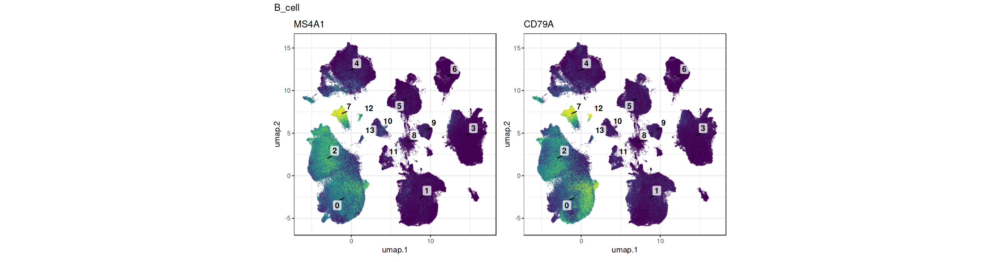

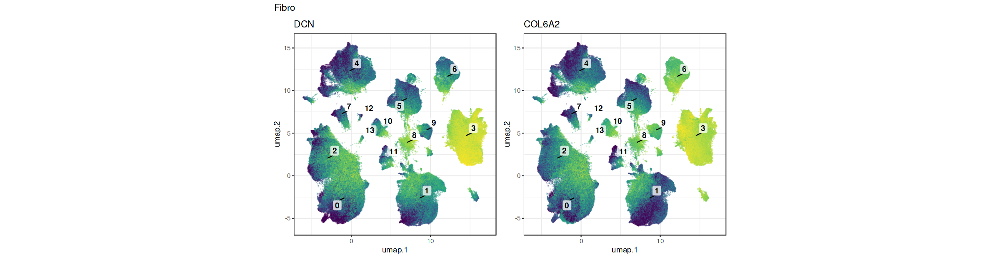

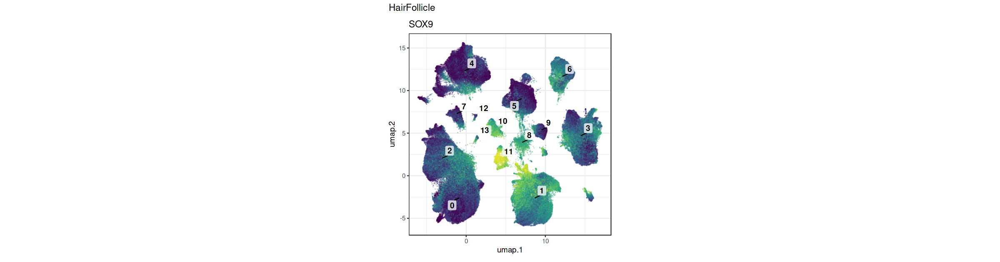

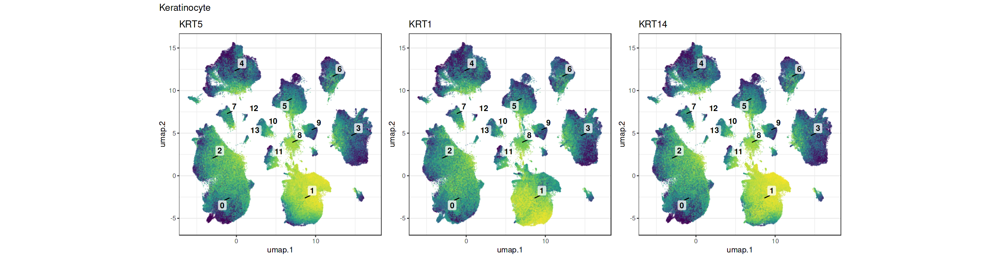

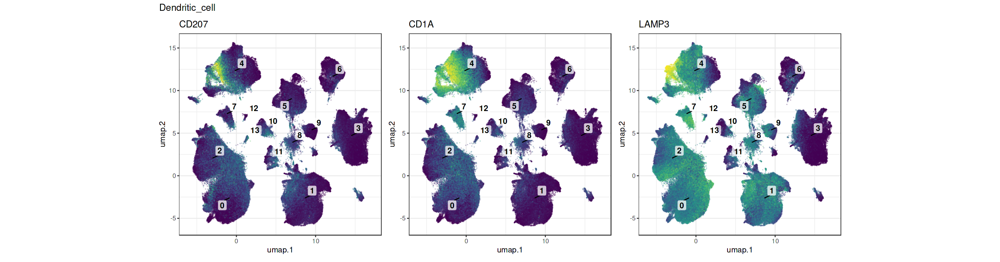

...

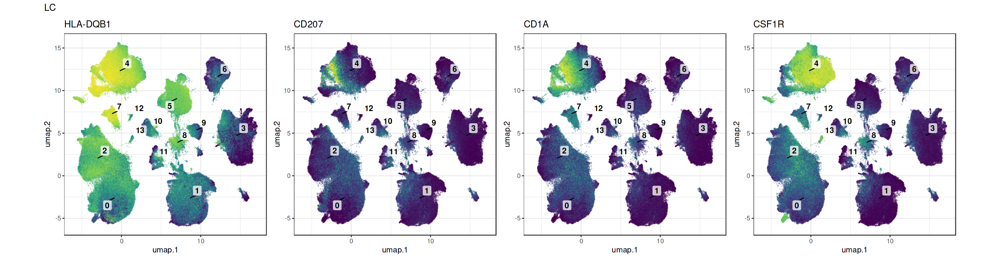

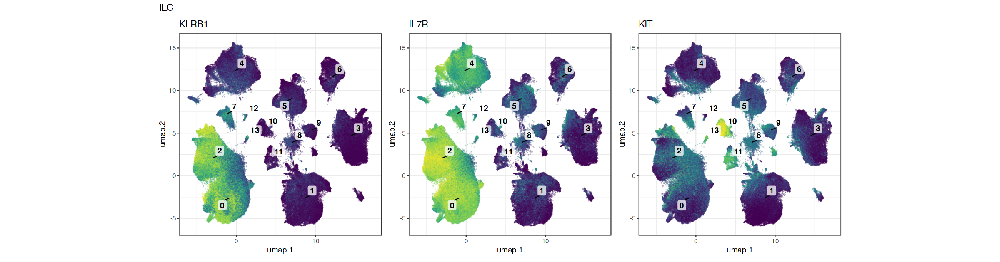

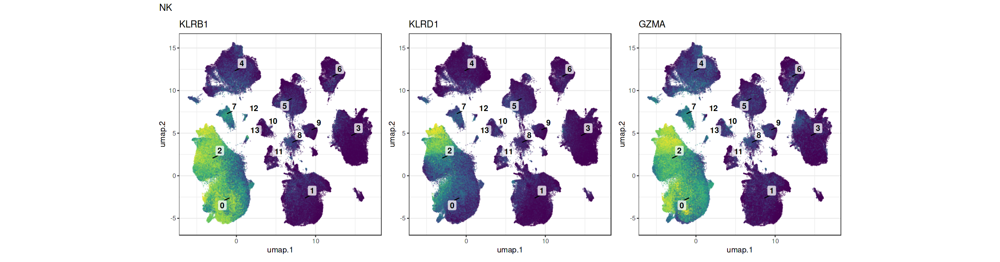

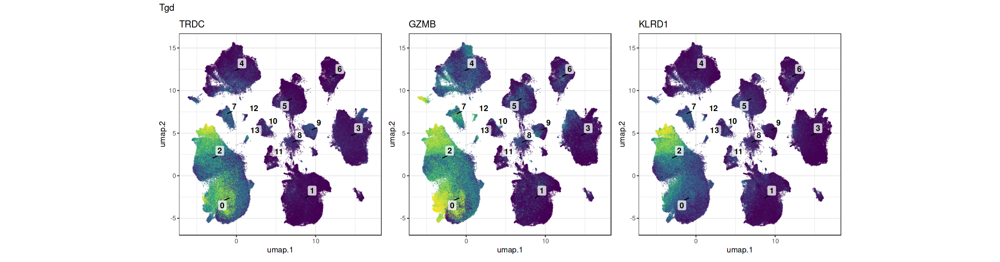

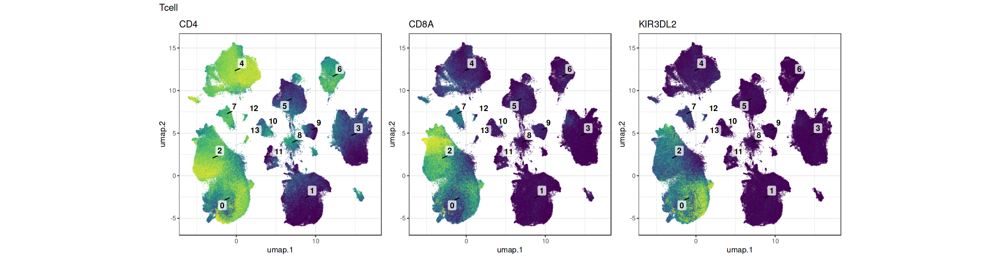

In [14]:
options(repr.plot.width=4*5, repr.plot.height=5.25)
iwalk(gating_single, function(markers, celltype){
    
    markers %<>% intersect(gsub("VI_", "", rownames(altExp(sce, "VI_RNA"))))
    
    plots <- map(markers, function(marker){
        scutility::plot_dimred(sce, dimred="umap", rasterise=TRUE, 
                               colour_by=paste0("VI_", marker), text_by="leiden_scANVI_02", 
                               scale_color=scale_color_viridis_c(trans="log1p"),
                               min.cutoff='q5', max.cutoff='q99.9',
                               point_size=0.015, point_alpha=0.25, shuffle=TRUE) + 
            theme(legend.position="none", aspect.ratio=1) + 
            ggtitle(marker)
    })

    print(wrap_plots(plots, nrow=1) + patchwork::plot_annotation(title=celltype))
})

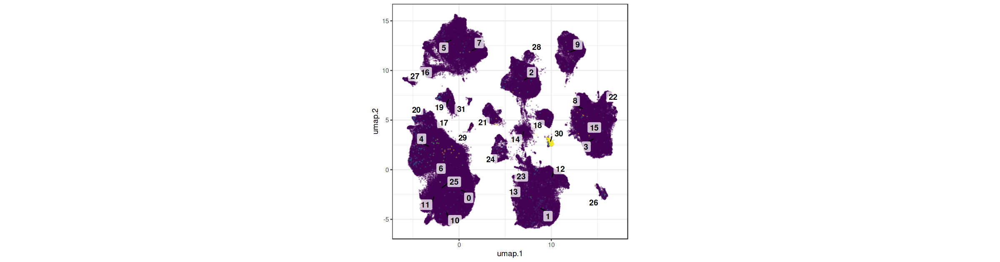

In [18]:
scutility::plot_dimred(sce, dimred="umap", 
                               colour_by="NRXN1", text_by="leiden_scANVI_10", 
                               #scale_color=scale_color_viridis_c(trans="log1p"),
                               min.cutoff='q1', max.cutoff='q99.9',
                               point_size=0.015, point_alpha=0.25, order=TRUE) + 
            theme(legend.position="none", aspect.ratio=1)

In [66]:
celltype_leiden_scANVI_02 <- list(
    "T/NK cells"=c("0", "2"),
    "B cells"=c("7"),
    "Keratinocytes"=c("1", "11", "8"),
    "Fibroblasts"=c("3", "6"),
    "Myeloid cells"=c("4"),
    "Endothelial cells"=c("5", "9"),
    "Melanocytes"=c("10"),
    "Mast cells"=c("13"),
    "Plasma cells"=c("12")
)

celltype_leiden_scANVI_10 <- list(
    "pDC"=c("27"),
    "Schwann cells"=c("30"),
    "Adipocytes"=c("26")
)

In [91]:
sce$cell_type <- NA
cell_types <- names(celltype_leiden_scANVI_02)

for(i in seq_along(celltype_leiden_scANVI_02)){
    print(cell_types[i])
    sce$cell_type[as.character(sce$leiden_scANVI_02) %in% celltype_leiden_scANVI_02[[i]]] <- cell_types[i]
}

cell_types <- names(celltype_leiden_scANVI_10)

for(i in seq_along(celltype_leiden_scANVI_10)){
    sce$cell_type[as.character(sce$leiden_scANVI_10) %in% celltype_leiden_scANVI_10[[i]]] <- cell_types[i]
}

[1] "T/NK cells"
[1] "B cells"
[1] "Keratinocytes"
[1] "Fibroblasts"
[1] "Myeloid cells"
[1] "Endothelial cells"
[1] "Melanocytes"
[1] "Mast cells"
[1] "Plasma cells"


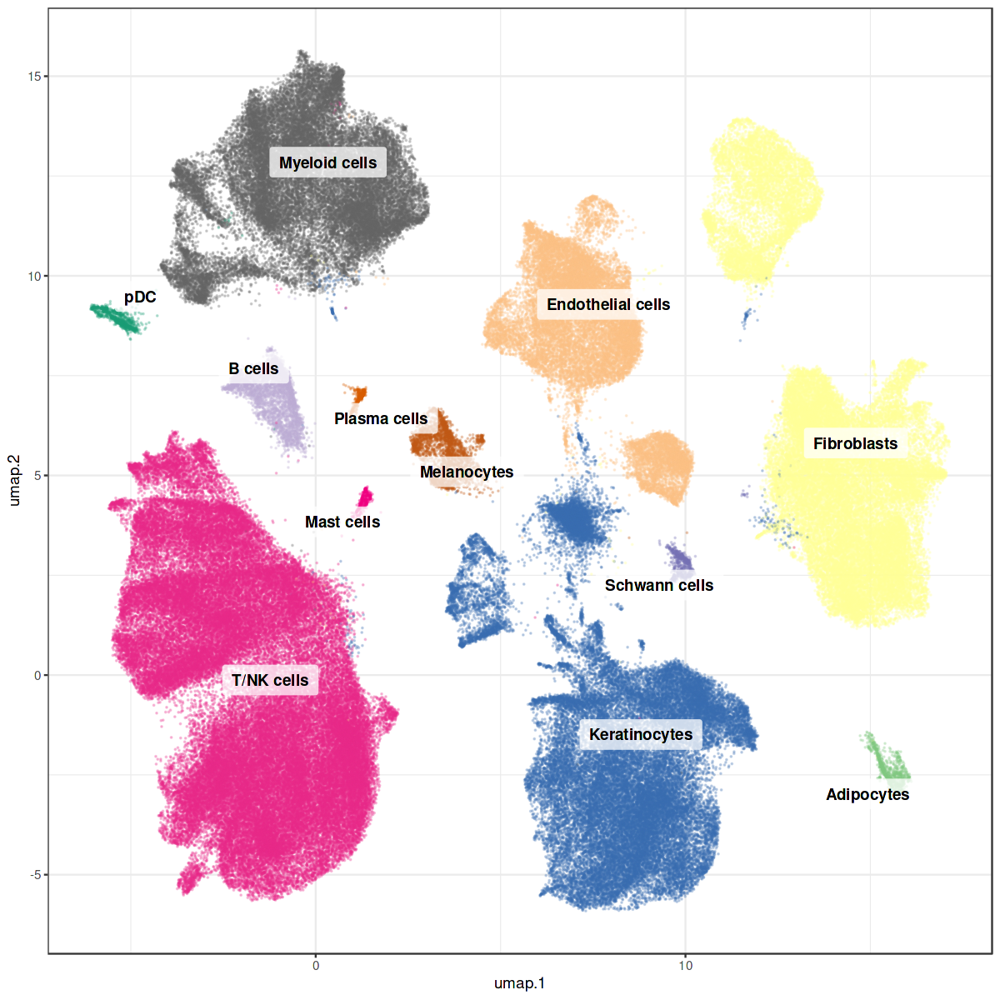

In [50]:
options(repr.plot.width=10, repr.plot.height=10)
scutility::plot_dimred(sce, dimred="umap", colour_by="cell_type", text_by="cell_type",
                       scale_color=scale_color_manual(values=scutility::colors_get_distinct()),
                       point_size=0.015, point_alpha=0.25, shuffle=TRUE) + 
    theme(legend.position="none")

In [92]:
subclustering <- c("T/NK cells"="skin_Tcells")

sce_subclusters <- map(subclustering, ~ multisce_load(here::here("data", "multisce", .x), main_name=NULL, reduceddim_include=c("umap")))

Loading coldata from /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin_Tcells/coldata.rds

Loading umap from /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin_Tcells/reducedDim/umap.rds



In [93]:
sce$cell_type.2 <- sce$cell_type

for(i in seq_along(sce_subclusters)){
    colData(sce)[colnames(sce_subclusters[[i]]), "cell_type.2"] <- sce_subclusters[[i]]$cell_type.2
}

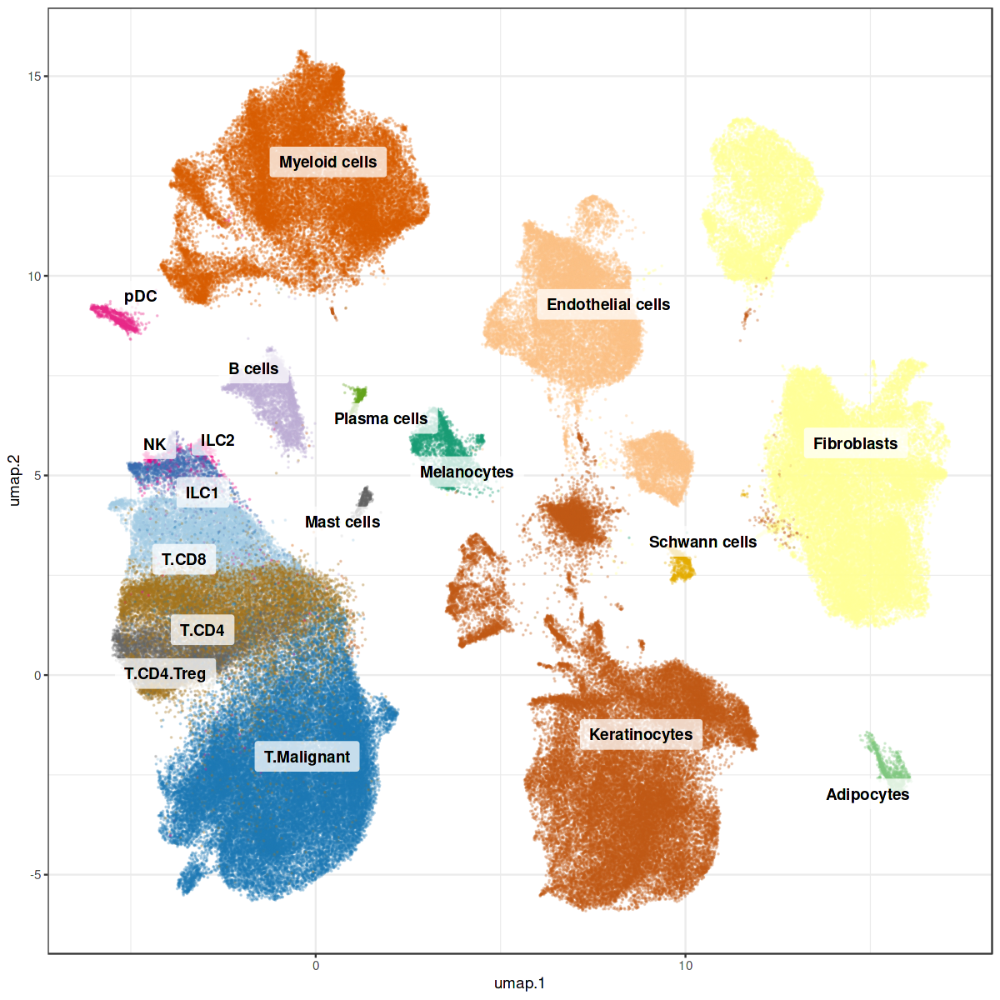

In [53]:
options(repr.plot.width=10, repr.plot.height=10)
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="cell_type.2", text_by="cell_type.2", 
                       scale_color=scale_color_manual(values=scutility::colors_get_distinct()),
                       point_size=0.015, point_alpha=0.25, shuffle=TRUE) + 
    theme(legend.position="none")

In [94]:
sce$cell_type[sce$cell_type.2 %in% c("T.CD4", "T.CD4.Treg", "T.CD8")] <- "T cells"
sce$cell_type[sce$cell_type.2 %in% c("T.Malignant")] <- "Malignant"
sce$cell_type[sce$cell_type.2 %in% c("ILC1", "ILC2", "NK")] <- "ILC"
sce$cell_type[sce$cell_type.2 %in% c("ILC1", "ILC2", "NK")] <- "ILC"

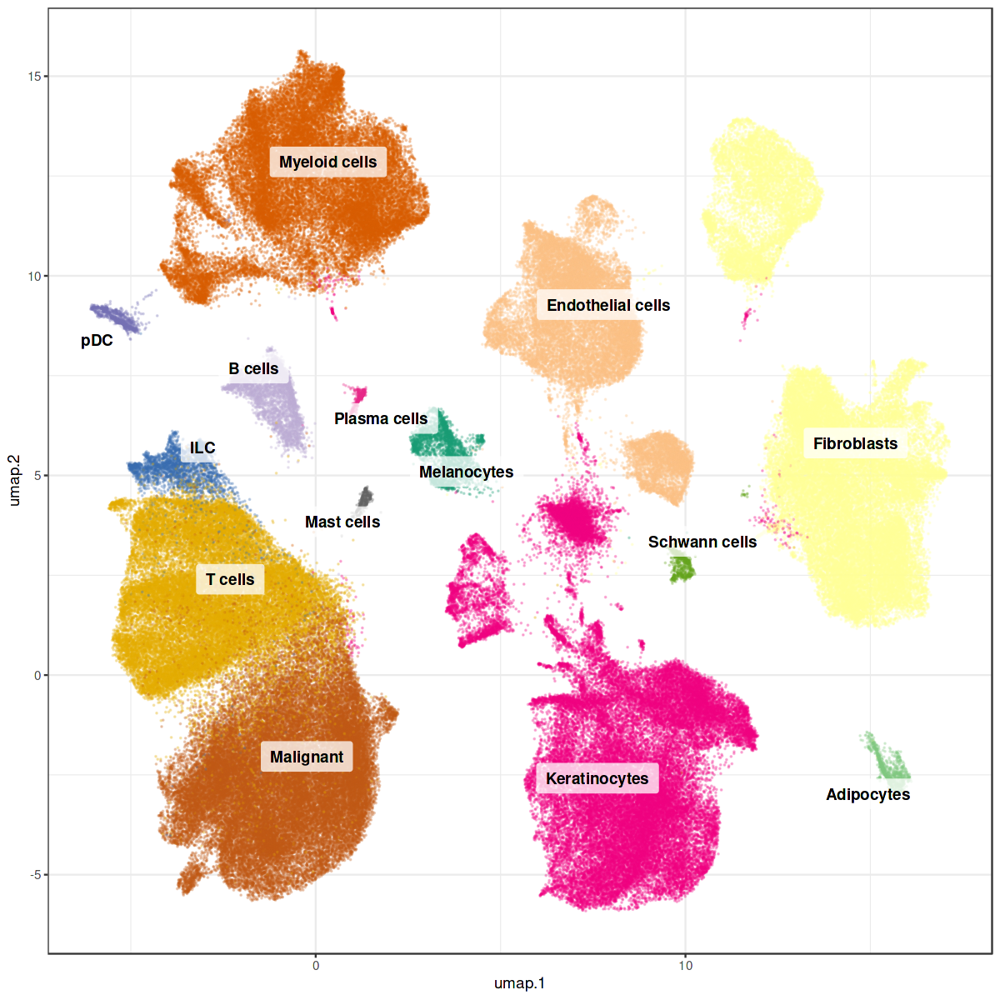

In [55]:
options(repr.plot.width=10, repr.plot.height=10)
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="cell_type", text_by="cell_type", 
                       scale_color=scale_color_manual(values=scutility::colors_get_distinct()),
                       point_size=0.015, point_alpha=0.25, shuffle=TRUE) + 
    theme(legend.position="none")

In [95]:
sce$cell_type[sce$cell_type == "Keratinocytes" & reducedDim(sce, "umap")[,1] < 2.5 & reducedDim(sce, "umap")[,2] < 7.5] <- "Malignant"
sce$cell_type.2[sce$cell_type.2 == "Keratinocytes" & reducedDim(sce, "umap")[,1] < 2.5 & reducedDim(sce, "umap")[,2] < 7.5] <- "T.Malignant"
sce$cell_type[sce$cell_type == "Keratinocytes" & reducedDim(sce, "umap")[,1] < 2.5 & reducedDim(sce, "umap")[,2] > 7.5] <- "Myeloid cells"
sce$cell_type.2[sce$cell_type.2 == "Keratinocytes" & reducedDim(sce, "umap")[,1] < 2.5 & reducedDim(sce, "umap")[,2] > 7.5] <- "Myeloid cells"
sce$cell_type[sce$cell_type == "Keratinocytes" & reducedDim(sce, "umap")[,1] > 10 & reducedDim(sce, "umap")[,2] > 2.5] <- "Fibroblasts"
sce$cell_type.2[sce$cell_type.2 == "Keratinocytes" & reducedDim(sce, "umap")[,1] > 10 & reducedDim(sce, "umap")[,2] > 2.5] <- "Fibroblasts"

In [96]:
cell_lineage <- c("T cells"="T lymphocyte",
                  "Malignant"="Malignant",
                  "Fibroblasts"="Fibroblast",
                  "Myofibroblasts"="Fibroblast",
                  "Endothelial cells"="Endothelial",
                  "B cells"="B lymphocyte",
                  "Plasma cells"="B lymphocyte",
                  "Myeloid cells"="Myeloid", 
                  "Mast cells"="Myeloid", 
                  "pDC"="Myeloid",
                  "Keratinocytes"="Epithelial",
                  "Melanocytes"="Other",
                  "Schwann cells"="Other",
                  "ILC"="ILC",
                  "Adipocytes"="Other")

In [97]:
sce$cell_lineage <- cell_lineage[as.character(sce$cell_type)]

In [98]:
sce$cell_lineage %<>% factor(levels=c("Malignant", "T lymphocyte", "B lymphocyte", "Myeloid", "Epithelial", "Fibroblast", "Endothelial", "ILC", "Other"))

In [99]:
colors <- list()
colors[["cell_lineage"]] <- setNames(c(RColorBrewer::brewer.pal(8, "Set1")[-c(6)], "#30D5C8", "darkgrey"), levels(sce$cell_lineage))
colors[["cell_type"]] <- scutility::color_subcluster(subcluster=sce$cell_type, cluster=sce$cell_lineage, cluster_colors=colors[["cell_lineage"]], brightness_change=0.12)
colors[["cell_type.2"]] <- scutility::color_subcluster(subcluster=sce$cell_type.2, cluster=sce$cell_lineage, cluster_colors=colors[["cell_lineage"]], brightness_change=0.12)

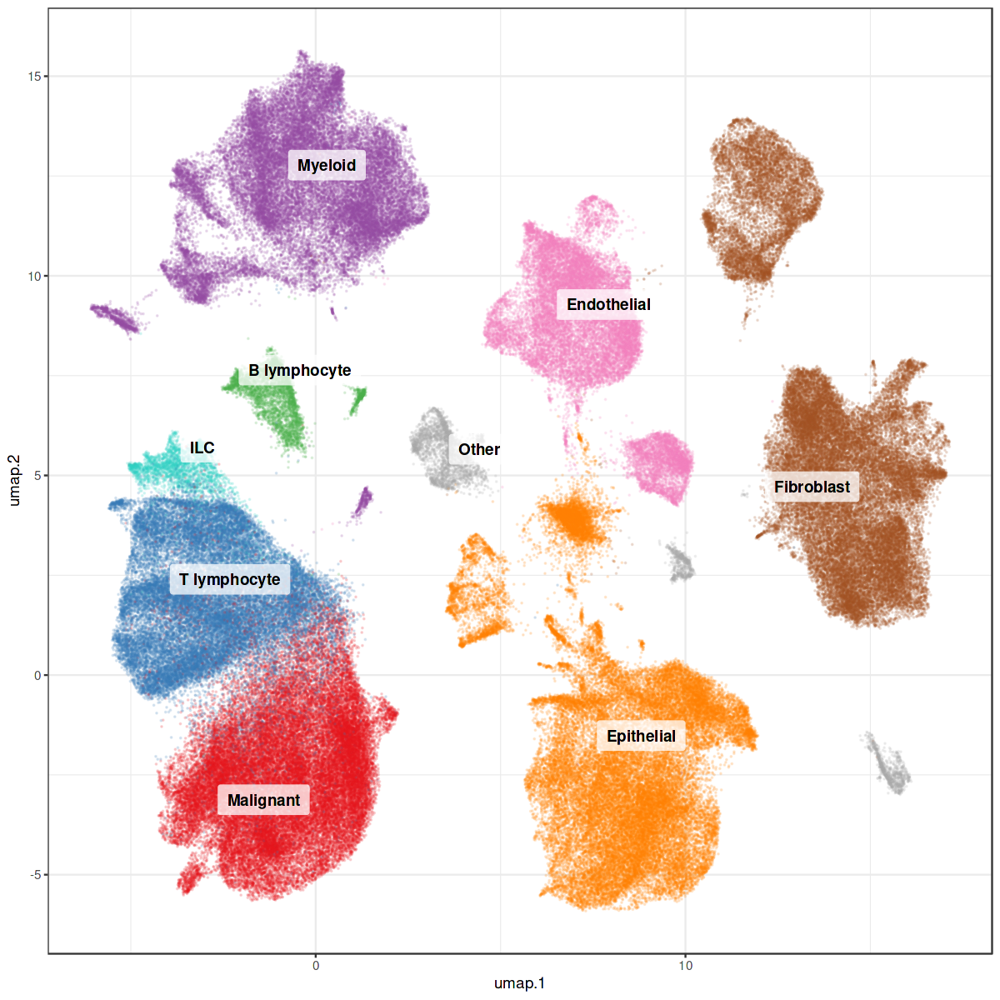

In [100]:
options(repr.plot.width=10, repr.plot.height=10)
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="cell_lineage", text_by="cell_lineage", 
                       scale_color=scale_color_manual(values=colors[["cell_lineage"]]),
                       point_size=0.025, point_alpha=0.15, shuffle=TRUE) + 
    theme(legend.position="none")

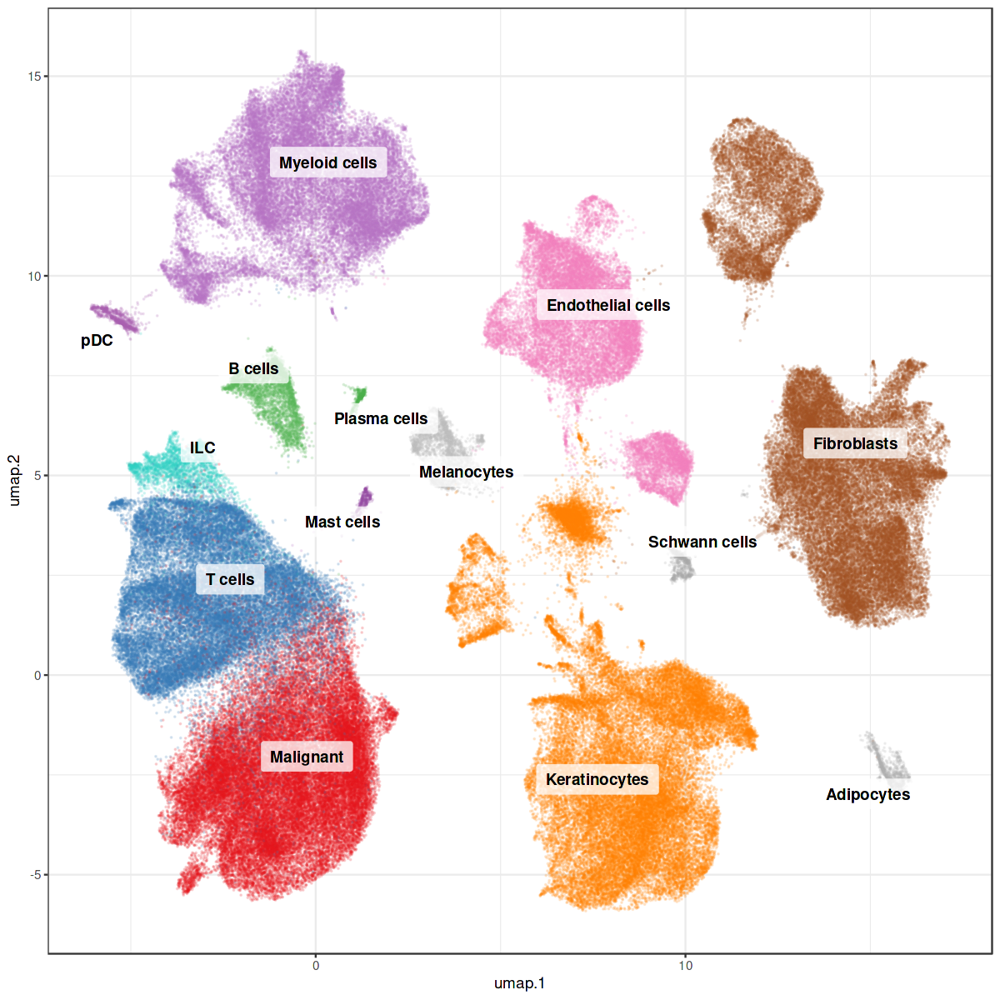

In [101]:
options(repr.plot.width=10, repr.plot.height=10)
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="cell_type", text_by="cell_type", 
                       scale_color=scale_color_manual(values=colors[["cell_type"]]),
                       point_size=0.025, point_alpha=0.15, shuffle=TRUE) + 
    theme(legend.position="none")

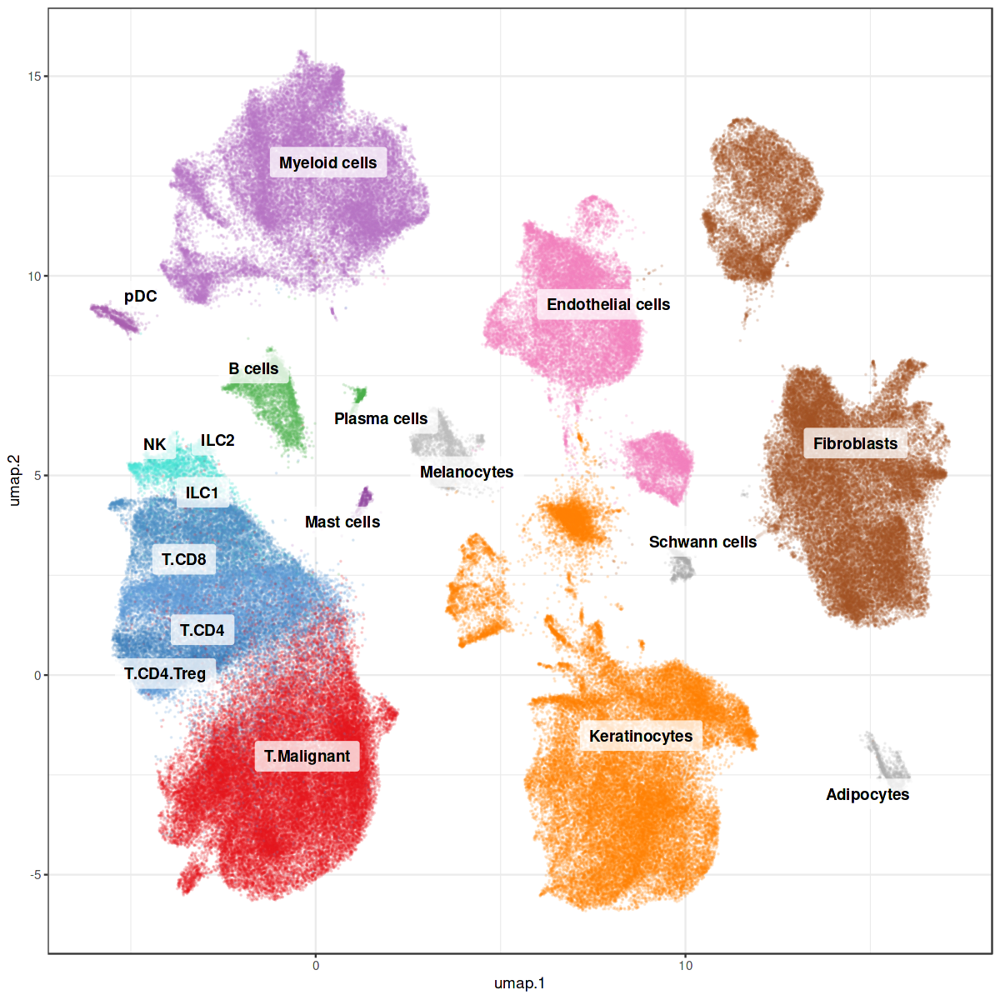

In [102]:
options(repr.plot.width=10, repr.plot.height=10)
scutility::plot_dimred(sce, dimred="umap", 
                       colour_by="cell_type.2", text_by="cell_type.2", 
                       scale_color=scale_color_manual(values=colors[["cell_type.2"]]),
                       point_size=0.025, point_alpha=0.15, shuffle=TRUE) + 
    theme(legend.position="none")

In [103]:
metadata(sce)$colors <- colors

In [104]:
sce$cell_lineage %<>% factor(levels=names(metadata(sce)$colors[["cell_lineage"]]))
sce$cell_type %<>% factor(levels=names(metadata(sce)$colors[["cell_type"]]))
sce$cell_type.2 %<>% factor(levels=names(metadata(sce)$colors[["cell_type.2"]]))

In [37]:
multisce_save(sce, path=here::here("data", "multisce", "skin"))

Creating directory:  /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/sce

Saving VI_RNA to /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/sce/VI_RNA.rds

Creating directory:  /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/reducedDim

Saving scANVI to /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/reducedDim/scANVI.rds

Saving umap to /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/reducedDim/umap.rds

Saving scVI to /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/reducedDim/scVI.rds

Saving coldata to /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/coldata.rds

Creating directory:  /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/metadata

Saving colors to /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/metadata/colors.rds

Saving RNA to /home/tbb/git/CTCL_KC_HLAII/data/multisce/skin/sce/RNA.rds

